# HomeWork 2

## Name: Ashvant Ram Selvam

## Student id: 8569202378

# Question 1

# 1C Feature Classification:

(i) Time Domain Features used in Time series Classification are:
    
    Mean, Median, Max, Min, Standard Deviation, 1st Quartile, 3rd Quartile and Interquartile Range.

(ii)Extraction of Time-Domain Features:

In [1]:
import pandas as pd
import os
from collections import defaultdict
import matplotlib.pyplot as plt

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
def getTrainingFeatures(activity):
    root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            datapointFrame.setdefault("dataset",[]).append(activity + " " + file)
            meanFrame = fileContents.mean()
            medianFrame = fileContents.median()
            maxFrame = fileContents.max()
            minFrame = fileContents.min()
            stdFrame = fileContents.std()
            firstQuartileFrame = fileContents.quantile(0.25)
            thirdQuartileFrame = fileContents.quantile(0.75)
            for col in col_Names:
                datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                datapointFrame.setdefault(col+"_median",[]).append(medianFrame[col])
                datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                datapointFrame.setdefault(col+"_min",[]).append(minFrame[col])
                datapointFrame.setdefault(col+"_std",[]).append(stdFrame[col])
                datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
            datapointFrame.setdefault("activity",[]).append(activity)
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame
            
            
activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]
frames = []
trainingData = pd.DataFrame()
for activity in activityList:
    activityFrame = getTrainingFeatures(activity)
    frames.append(activityFrame)
trainingData = pd.concat(frames)

print(trainingData)


/Users/ashvant/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')
/Users/ashvant/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


    activity  avg_rss12_IQR  avg_rss12_max  avg_rss12_mean  avg_rss12_median  \
0   bending1         1.3600          48.00       43.969125            44.500   
1   bending1         2.5000          48.00       43.454958            43.250   
2   bending1         5.8500          47.75       42.179813            43.500   
3   bending1         1.4200          45.75       41.678063            41.750   
4   bending1         2.0000          47.40       43.954500            44.330   
0   bending2         4.3125          47.50       31.058250            29.710   
1   bending2         1.2700          33.00       29.881938            30.000   
2   bending2        11.2500          45.50       30.938104            29.000   
3   bending2         8.3125          50.00       32.586208            33.000   
0    cycling         5.2500          44.75       36.863375            36.330   
1    cycling         5.7500          45.00       37.114312            36.250   
2    cycling         5.0000          44.

All features are extracted and consolidated into a single dataframe for further evaluations

(iii) Standard deviation for the above extracted features.

In [2]:
featureStdFrame = trainingData.std()
print(featureStdFrame)

avg_rss12_IQR       3.097013
avg_rss12_max       4.429182
avg_rss12_mean      4.917717
avg_rss12_median    4.956111
avg_rss12_min       8.794295
avg_rss12_std       1.758629
avg_rss13_IQR       1.941865
avg_rss13_max       4.759853
avg_rss13_mean      3.863304
avg_rss13_median    3.845730
avg_rss13_min       3.053869
avg_rss13_std       0.996008
avg_rss23_IQR       1.981007
avg_rss23_max       5.449726
avg_rss23_mean      5.120513
avg_rss23_median    5.267414
avg_rss23_min       5.368786
avg_rss23_std       1.057973
var_rss12_IQR       1.249460
var_rss12_max       5.147841
var_rss12_mean      1.600661
var_rss12_median    1.436903
var_rss12_min       0.000000
var_rss12_std       0.902769
var_rss13_IQR       0.755968
var_rss13_max       2.302408
var_rss13_mean      1.179781
var_rss13_median    1.149585
var_rss13_min       0.000000
var_rss13_std       0.473525
var_rss23_IQR       0.799634
var_rss23_max       2.540166
var_rss23_mean      1.171306
var_rss23_median    1.104626
var_rss23_min 

Confidence interval using bootstrapping:

In [3]:
import numpy as np
import bootstrapped.bootstrap as bs
import bootstrapped.stats_functions as bs_stats
trainingData = trainingData.drop(['activity','dataset'],axis=1)
for col in trainingData.columns:
    print(col)
    print(bs.bootstrap(np.array(trainingData[col]), stat_func=bs_stats.std))

avg_rss12_IQR
3.074488606355733    (2.594259007377925, 3.595679772572623)
avg_rss12_max
4.396968872496198    (3.2541061049815276, 5.73657387448928)
avg_rss12_mean
4.88195084823011    (4.2454107356522295, 5.563714504456716)
avg_rss12_median
4.920065980691552    (4.26340701498287, 5.64067558686652)
avg_rss12_min
8.730335507644277    (7.206828386750409, 10.141885180318834)
avg_rss12_std
1.7458389584050433    (1.5161221108076641, 1.9932027548100273)
avg_rss13_IQR
1.9277425042185714    (1.5610950318889532, 2.348529005504876)
avg_rss13_max
4.725235820588898    (3.97083359168464, 5.639416372324222)
avg_rss13_mean
3.8352068698335797    (3.1874715982921957, 4.6225295834642495)
avg_rss13_median
3.817761059365321    (3.136551718174199, 4.664084780697413)
avg_rss13_min
3.031658816140715    (2.835706414294444, 3.294469832863427)
avg_rss13_std
0.9887645694105425    (0.7441938608686509, 1.2363305567069172)
avg_rss23_IQR
1.9665994649855825    (1.519460659167847, 2.4749010749536686)
avg_rss23_max
5.410

(iv)features selected for further analysis: Mean, InterQuartile Range, Max

# 1D - Binary Classification:

(i)Assume that you want to use the training set to classify bending from other
activities, i.e. you have a binary classification problem. Depict scatter plots
of the features you specified in 1(c)iv extracted from time series 1, 2, and 6 of
each instance, and use color to distinguish bending vs. other activities. (See
p. 120 of the textbook).

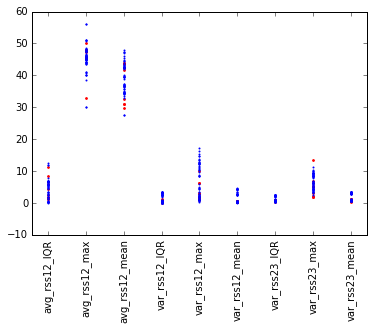

In [4]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
def getTrainingFeatures(activity,splitSize):
    root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["time","avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            size = len(fileContents.index)
            segment = int(size/splitSize)
#            print(size)
#            print(segment)
            dfList = []
            for i in range(0,size,int(segment)):
                dfList.append(fileContents[i:segment+i])
            set = 0
            for df in dfList:
                datapointFrame.setdefault("dataset",[]).append(activity + " " + file+" "+str(set))
                meanFrame = df.mean()
                medianFrame = df.median()
                maxFrame = df.max()
                minFrame = df.min()
                stdFrame = df.std()
                firstQuartileFrame = df.quantile(0.25)
                thirdQuartileFrame = df.quantile(0.75)
                for col in col_Names:
                    datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                    datapointFrame.setdefault(col+"_median",[]).append(medianFrame[col])
                    datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                    datapointFrame.setdefault(col+"_min",[]).append(minFrame[col])
                    datapointFrame.setdefault(col+"_std",[]).append(stdFrame[col])
                    datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
                datapointFrame.setdefault("activity",[]).append(activity)
                set+=1
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame
            
            
activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]
frames = []
trainingData = pd.DataFrame()
for activity in activityList:
    activityFrame = getTrainingFeatures(activity,1)
    frames.append(activityFrame)
trainingData = pd.concat(frames)
featureStdFrame = trainingData.std()
#print(featureStdFrame)
# print(trainingData)

features126DataFrame = pd.DataFrame()
features126DataFrame = trainingData[["activity","avg_rss12_mean","avg_rss12_IQR","avg_rss12_max","var_rss12_mean","var_rss12_IQR","var_rss12_max","var_rss23_mean","var_rss23_IQR","var_rss23_max"]]
#print(features126DataFrame)
bendingData = pd.concat([features126DataFrame.loc[features126DataFrame['activity'] == "bending1"],features126DataFrame.loc[features126DataFrame['activity'] == "bending2"]])
nonBendingData = features126DataFrame.loc[features126DataFrame['activity'] != "bending1"]
nonBendingData = nonBendingData.loc[nonBendingData['activity'] != "bending2"]

#print(bendingData)
#print(nonBendingData)
#print(bs.bootstrap(TrainingData, stat_func=bs_stats.std))
#ax = bendingData.plot(kind='scatter',x="1",y=list(bendingData.columns.values)[1:],color='Red', label='G1')
#bendingData.plot.scatter(x="index",y=list(bendingData.columns.values)[1:])
#plt.show()
bendingData = bendingData.drop(["activity"],axis=1)
bendingData = bendingData.melt()
nonBendingData = nonBendingData.drop(["activity"],axis=1)
nonBendingData = nonBendingData.melt()
groups = bendingData.groupby('variable')
fig, ax = plt.subplots()
x_ticks = []
x_ticklabels = []
for i, (name, group) in enumerate(groups):
    y = group.value
    x = [i]*len(y)
    ax.scatter(x, y,color='Red',label='bending',s=3)
    x_ticks.append(i)
    x_ticklabels.append(name)


ax.set_xticks(x_ticks)   
ax.set_xticklabels(x_ticklabels);

groups = nonBendingData.groupby('variable')
x_ticks = []
x_ticklabels = []
for i, (name, group) in enumerate(groups):
    y = group.value
    x = [i]*len(y)
    
    ax.scatter(x, y,color='Blue',label='non-bending',s=1)
    x_ticks.append(i)
    x_ticklabels.append(name)

ax.set_xticks(x_ticks)   
ax.set_xticklabels(x_ticklabels)
plt.xticks(rotation=90)

plt.show()

ii. Break each time series in your training set into two (approximately) equal
length time series and repeat the experiment in 1(d)i. Do you see any considerable
difference in the results with those of 1(d)i?

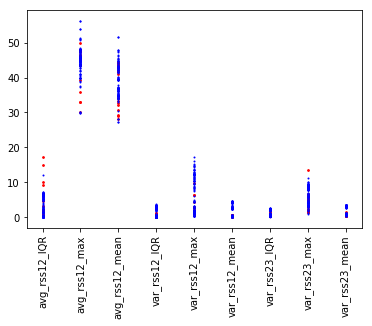

In [32]:
def getTrainingFeatures(activity,splitSize):
    root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["time","avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            size = len(fileContents.index)
            segment = int(size/splitSize)
#            print(size)
#            print(segment)
            dfList = []
            for i in range(0,size,int(segment)):
                dfList.append(fileContents[i:segment+i])
            set = 0
            for df in dfList:
                datapointFrame.setdefault("dataset",[]).append(activity + " " + file+" "+str(set))
                meanFrame = df.mean()
                medianFrame = df.median()
                maxFrame = df.max()
                minFrame = df.min()
                stdFrame = df.std()
                firstQuartileFrame = df.quantile(0.25)
                thirdQuartileFrame = df.quantile(0.75)
                for col in col_Names:
                    datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                    datapointFrame.setdefault(col+"_median",[]).append(medianFrame[col])
                    datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                    datapointFrame.setdefault(col+"_min",[]).append(minFrame[col])
                    datapointFrame.setdefault(col+"_std",[]).append(stdFrame[col])
                    datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
                datapointFrame.setdefault("activity",[]).append(activity)
                set+=1
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame

activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]
frames = []
trainingData = pd.DataFrame()
for activity in activityList:
    activityFrame = getTrainingFeatures(activity,2)
    frames.append(activityFrame)
trainingData = pd.concat(frames)
featureStdFrame = trainingData.std()
#print(featureStdFrame)
# print(trainingData)

features126DataFrame = pd.DataFrame()
features126DataFrame = trainingData[["activity","avg_rss12_mean","avg_rss12_IQR","avg_rss12_max","var_rss12_mean","var_rss12_IQR","var_rss12_max","var_rss23_mean","var_rss23_IQR","var_rss23_max"]]
#print(features126DataFrame)
bendingData = pd.concat([features126DataFrame.loc[features126DataFrame['activity'] == "bending1"],features126DataFrame.loc[features126DataFrame['activity'] == "bending2"]])
nonBendingData = features126DataFrame.loc[features126DataFrame['activity'] != "bending1"]
nonBendingData = nonBendingData.loc[nonBendingData['activity'] != "bending2"]

#print(bendingData)
#print(nonBendingData)
#print(bs.bootstrap(TrainingData, stat_func=bs_stats.std))
#ax = bendingData.plot(kind='scatter',x="1",y=list(bendingData.columns.values)[1:],color='Red', label='G1')
#bendingData.plot.scatter(x="index",y=list(bendingData.columns.values)[1:])
#plt.show()
bendingData = bendingData.drop(["activity"],axis=1)
bendingData = bendingData.melt()
nonBendingData = nonBendingData.drop(["activity"],axis=1)
nonBendingData = nonBendingData.melt()
groups = bendingData.groupby('variable')
fig, ax = plt.subplots()
x_ticks = []
x_ticklabels = []
for i, (name, group) in enumerate(groups):
    y = group.value
    x = [i]*len(y)
    ax.scatter(x, y,color='Red',label='bending',s=3)
    x_ticks.append(i)
    x_ticklabels.append(name)


ax.set_xticks(x_ticks)   
ax.set_xticklabels(x_ticklabels);

groups = nonBendingData.groupby('variable')
x_ticks = []
x_ticklabels = []
for i, (name, group) in enumerate(groups):
    y = group.value
    x = [i]*len(y)
    
    ax.scatter(x, y,color='Blue',label='non-bending',s=1)
    x_ticks.append(i)
    x_ticklabels.append(name)

ax.set_xticks(x_ticks)   
ax.set_xticklabels(x_ticklabels)
plt.xticks(rotation=90)

plt.show()

Comparing the two graphs we see that the bending data(red points) are better separated from non-bending data(blue points) when the dataset is split into two. There are more datapoints available for training too. Hence this will have apositive effect on classification and also help in reducing imbalance.

iii. Break each time series in your training set into l ∈ {1, 2, . . . , 10} time series of approximately equal length and use logistic regression to solve the binary classification problem, using time-domain features. Calculate the p-values for your logistic regression parameters and refit a logistic regression model using your pruned set of features.4 Alternatively, you can use backward selection using sklearn.feature selection or glm in R. Use 5-fold cross-validation to determine the best value of l. Explain what the right way and the wrong way are to perform cross-validation in this problem. Obviously, use the right way!

In [134]:
import pandas as pd
import os
from collections import defaultdict
import matplotlib.pyplot as plt
#import bootstrapped.bootstrap as bs
#import bootstrapped.stats_functions as bs_stats
import statsmodels.formula.api as sm
from patsy import dmatrices, build_design_matrices
from sklearn import preprocessing
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
def getTrainingFeatures2(activity,splitSize,Test):
    if(Test):
        root_dir = "AReM/Test/"+activity
    else:
        root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["time","avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            if(Test):
                fileContents = pd.read_csv("AReM/Test/"+activity+"/"+file,comment="#",names=col_Names)
            else:
                fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            size = len(fileContents.index)
            segment = int(size/splitSize)
#            print(size)
#            print(segment)
            dfList = []
            for i in range(0,size,int(segment)):
#                print(i)
                dfList.append(fileContents[i:segment+i])
            for df in dfList:
                meanFrame = df.mean()
                maxFrame = df.max()
                firstQuartileFrame = df.quantile(0.25)
                thirdQuartileFrame = df.quantile(0.75)
                colNames=["avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
                for col in colNames:
                    datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                    datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                    datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
                if(activity=="bending1" or activity=="bending2"):
                    datapointFrame.setdefault("activity",[]).append(1)
                else:
                    datapointFrame.setdefault("activity",[]).append(0)
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame
            
            
activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]

Resultstring = ""
leastErrorLvalue = 0
leastError = 100
savedFeaturesforL  = pd.DataFrame()
savedLabelsforL = pd.DataFrame()
for i in range(1,11):
    trainingData = pd.DataFrame()
    frames = []
    for activity in activityList:
        activityFrame = getTrainingFeatures2(activity,i,0)
        frames.append(activityFrame)
    trainingData = pd.concat(frames)
    featureStdFrame = trainingData.std()
    #print(featureStdFrame)
#    print(trainingData)
    trainingData.to_csv("outsplit"+str(i)+".csv", sep='\t', encoding='utf-8')
    headers=""
    for colName in list(trainingData.columns.values)[1:]:
        headers+=colName+" + "
#    print(headers[:-2])
    kf = StratifiedKFold(n_splits=5,shuffle = True)
    new_index= list(range(0,len(trainingData)))
    allLabels = trainingData["activity"]
    allFeatures = trainingData.iloc[:,1:]
    df_normalized = (allFeatures - allFeatures.min()) / (allFeatures.max() - allFeatures.min())
#    df_normalized = trainingData
    df_normalized.index = new_index
    allLabels.index = new_index
#    print(df_normalized)
    n=0
    sumOfError=0
    
    for train, test in kf.split(df_normalized,allLabels):
        resultFrame = pd.DataFrame()
        trainFeatures = df_normalized.ix[train]
        trainLabels = allLabels.ix[train]
        testFeatures = df_normalized.ix[test]
        testLabels = allLabels.ix[test]
#        print(testLabels)
        
        model1 = SelectKBest(chi2).fit(trainFeatures, trainLabels)
        columns = trainFeatures.columns
        labels = [columns[x] for x in model1.get_support(indices=True) if x]
#        newTrain = pd.DataFrame(model1.transform(trainFeatures),columns=labels)
        newTrain = trainFeatures[labels]
#        newTest = pd.DataFrame(model1.transform(testFeatures),columns=labels)
        newTest = testFeatures[labels]
        newTrain.index = trainFeatures.index
        newTest.index = testLabels.index
        model = sm.Logit(trainLabels,newTrain)
        result = model.fit(maxiter =15)
#        print(newTest)
        logisticRegr = LogisticRegression(max_iter=10).fit(newTrain, trainLabels)
        resultFrame["predicted"] = result.predict(newTest)
        mask1 = resultFrame["predicted"]>0.5
        mask = resultFrame["predicted"]<=0.5
        resultFrame.ix[mask1,"predicted"] = 1
        resultFrame.ix[mask,"predicted"] = 0
        resultFrame["actual"] = testLabels
        print("*************************************** kthFold = "+str(n)+"*********** l value = "+str(i))
        print(result.summary())
#        print(resultFrame)
#         mse = mean_squared_error(resultFrame["actual"], resultFrame["predicted"])
        error = 1 - logisticRegr.score(newTest,testLabels)
        sumOfError+=error
#        print(mse)
        n+=1
#    print("For l = "+ str(i)+ "Average MSE = " + str(sumOfMSE/5))
    Resultstring += "For l = "+ str(i)+ "Average Error = " + str(sumOfError/5)+"\n"
    if((sumOfError/5)<leastError):
        leastError = sumOfError/5
        leastErrorLvalue = i
        savedFeaturesforL = df_normalized
        savedLabelsforL = allLabels
print(Resultstring)

print("\nLeast Error = "+ str(leastError)+ "\nBestLvalue = "+ str(leastErrorLvalue))




         Current function value: 0.000043
         Iterations: 15
*************************************** kthFold = 0*********** l value = 1
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                   55
Model:                          Logit   Df Residuals:                       45
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.9999
Time:                        12:26:15   Log-Likelihood:             -0.0023702
converged:                      False   LL-Null:                       -20.964
                                        LLR p-value:                 3.394e-06
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss13_max   -272.1547    924.058     -0.295      0.768   

Optimization terminated successfully.
         Current function value: 0.182949
         Iterations 12
*************************************** kthFold = 0*********** l value = 2
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  110
Model:                          Logit   Df Residuals:                      101
Method:                           MLE   Df Model:                            8
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.5200
Time:                        12:26:16   Log-Likelihood:                -20.124
converged:                       True   LL-Null:                       -41.929
                                        LLR p-value:                 6.745e-07
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss13_max     -2.953

Optimization terminated successfully.
         Current function value: 0.236354
         Iterations 11
*************************************** kthFold = 0*********** l value = 3
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  165
Model:                          Logit   Df Residuals:                      155
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3799
Time:                        12:26:17   Log-Likelihood:                -38.998
converged:                       True   LL-Null:                       -62.893
                                        LLR p-value:                 2.797e-07
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max     11.923

Optimization terminated successfully.
         Current function value: 0.268817
         Iterations 10
*************************************** kthFold = 0*********** l value = 4
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  220
Model:                          Logit   Df Residuals:                      210
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.2948
Time:                        12:26:18   Log-Likelihood:                -59.140
converged:                       True   LL-Null:                       -83.857
                                        LLR p-value:                 1.375e-07
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      5.443

Optimization terminated successfully.
         Current function value: 0.250269
         Iterations 11
*************************************** kthFold = 0*********** l value = 5
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  276
Model:                          Logit   Df Residuals:                      266
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3537
Time:                        12:26:20   Log-Likelihood:                -69.074
converged:                       True   LL-Null:                       -106.87
                                        LLR p-value:                 1.207e-12
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      0.389

Optimization terminated successfully.
         Current function value: 0.232392
         Iterations 11
*************************************** kthFold = 0*********** l value = 6
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  331
Model:                          Logit   Df Residuals:                      321
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3983
Time:                        12:26:21   Log-Likelihood:                -76.922
converged:                       True   LL-Null:                       -127.84
                                        LLR p-value:                 6.705e-18
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      1.683

Optimization terminated successfully.
         Current function value: 0.255586
         Iterations 11
*************************************** kthFold = 0*********** l value = 7
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  441
Model:                          Logit   Df Residuals:                      431
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3361
Time:                        12:26:23   Log-Likelihood:                -112.71
converged:                       True   LL-Null:                       -169.77
                                        LLR p-value:                 2.137e-20
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      7.927

Optimization terminated successfully.
         Current function value: 0.220090
         Iterations 11
*************************************** kthFold = 0*********** l value = 8
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  441
Model:                          Logit   Df Residuals:                      431
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.4283
Time:                        12:26:25   Log-Likelihood:                -97.060
converged:                       True   LL-Null:                       -169.77
                                        LLR p-value:                 7.836e-27
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      3.628

*************************************** kthFold = 4*********** l value = 8
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  443
Model:                          Logit   Df Residuals:                      433
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3076
Time:                        12:26:25   Log-Likelihood:                -119.05
converged:                       True   LL-Null:                       -171.95
                                        LLR p-value:                 1.051e-18
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      1.6633      3.048      0.546      0.585      -4.310       7.636
avg_rss23_mean     1.6878      2.693      0.

Optimization terminated successfully.
         Current function value: 0.255633
         Iterations 11
*************************************** kthFold = 4*********** l value = 9
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  552
Model:                          Logit   Df Residuals:                      542
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3398
Time:                        12:26:28   Log-Likelihood:                -141.11
converged:                       True   LL-Null:                       -213.74
                                        LLR p-value:                 8.430e-27
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      4.328

*************************************** kthFold = 4*********** l value = 10
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  553
Model:                          Logit   Df Residuals:                      543
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3743
Time:                        12:26:31   Log-Likelihood:                -133.83
converged:                       True   LL-Null:                       -213.88
                                        LLR p-value:                 7.101e-30
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      7.8816      3.060      2.575      0.010       1.884      13.880
avg_rss23_mean    -3.1494      2.755     -1

The summary of above results: 

Each model shown above is the model generated for that particular fold of data to the corresponding l-split of data. 
We calculated the k - fold cross validation train and test set. For each of the train and test sets we do feature selection and calculate Error which is averaged over all the folds.
Finally, we arrive at the l-value that has generated the least Error out of cross validation.
We again fit a model and do feature selection to arrive at the best model for the particular l-value.

The best L-split obtained in the above process is 9 with an Error of 0.078

The right and wrong way to do cross validatioon:
The right way is that we should split the k folds before we predict the data. We should select the subset of predictors during cross validation.
Wrong way is to train the model with the whole data, get the subset of predictors and then do cross validation only for l.

iv. Report the confusion matrix and show the ROC and AUC for your classifier.Report the parameters of your logistic regression βi’s as well as the p-value associated with them.

Optimization terminated successfully.
         Current function value: 0.253638
         Iterations 11
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  690
Model:                          Logit   Df Residuals:                      680
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3450
Time:                        12:41:48   Log-Likelihood:                -175.01
converged:                       True   LL-Null:                       -267.18
                                        LLR p-value:                 6.307e-35
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      4.9272      2.540      1.940      0.052      -0.052       9.906
avg_rss23_mean  

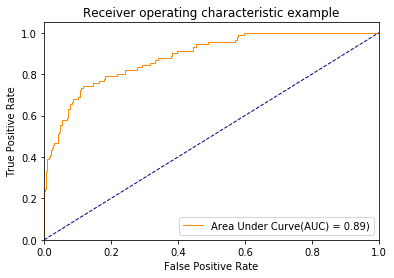

In [139]:
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectKBest

model1 = SelectKBest(chi2).fit(savedFeaturesforL, savedLabelsforL)

columns = savedFeaturesforL.columns
labels = [columns[x] for x in model1.get_support(indices=True) if x]
#        newTrain = pd.DataFrame(model1.transform(trainFeatures),columns=labels)
newTrain = savedFeaturesforL[labels]

newTrain.index = savedFeaturesforL.index
model = sm.Logit(savedLabelsforL,newTrain)
result = model.fit(maxiter =15)
print(result.summary(),"\n\n")
newTest = X_test[labels]
newTest.index = X_test.index
y_test.index = newTest.index
resultFrame = pd.DataFrame()
resultFrame["predicted"] = result.predict(newTrain)
resultFrame["score"] = resultFrame["predicted"]
mask1 = resultFrame["predicted"]>0.5
mask = resultFrame["predicted"]<=0.5
resultFrame.ix[mask1,"predicted"] = 1
resultFrame.ix[mask,"predicted"] = 0
resultFrame["actual"] = savedLabelsforL

tn, fp, fn, tp = confusion_matrix(resultFrame["actual"],resultFrame["predicted"]).ravel()
print("\t\tConfusion Matrix")
print("True Positives : ",tp)
print("True Negatives : ",tn)
print("False Positives : ",fp)
print("False Negatives : ",fn)

#Code from scikit learn documentation example

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(0,2):
    fpr[i], tpr[i], _ = roc_curve(resultFrame["actual"], resultFrame["score"])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(resultFrame["actual"].ravel(),  resultFrame["score"].ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 1
plt.plot(fpr[1], tpr[1], color='darkorange',
         lw=lw, label='Area Under Curve(AUC) = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

v. Test the classifier on the test set. Remember to break the time series in your test set into the same number of time series into which you broke your training set. Remember that the classifier has to be tested using the features extracted from the test set. Compare the accuracy on the test set with the cross-validation accuracy you obtained previously.

In [138]:
model1 = SelectKBest(chi2).fit(savedFeaturesforL, savedLabelsforL)

columns = savedFeaturesforL.columns
labels = [columns[x] for x in model1.get_support(indices=True) if x]
#        newTrain = pd.DataFrame(model1.transform(trainFeatures),columns=labels)
newTrain = savedFeaturesforL[labels]

newTrain.index = savedFeaturesforL.index
model = sm.Logit(savedLabelsforL,newTrain)
result = model.fit(maxiter =15)

print(result.summary(),"\n\n")
frames = list()
for activity in activityList:
    activityFrame = getTrainingFeatures2(activity,leastErrorLvalue,1)
    frames.append(activityFrame)
testingData = pd.concat(frames)
testLabels = testingData["activity"]
testFeatures = testingData.iloc[:,1:]
test_normalized = (testFeatures - testFeatures.min()) / (testFeatures.max() - testFeatures.min())
new_index= list(range(0,len(testingData)))
test_normalized.index = new_index
testLabels.index = new_index
newTest = test_normalized[labels]
resultFrame = pd.DataFrame()
logisticRegr = LogisticRegression(max_iter=10).fit(newTrain, savedLabelsforL)
error = 1 - logisticRegr.score(newTest,testLabels)
resultFrame["predicted"] = result.predict(newTest)
resultFrame["score"] = resultFrame["predicted"]
mask1 = resultFrame["predicted"]>0.5
mask = resultFrame["predicted"]<=0.5
resultFrame.ix[mask1,"predicted"] = 1
resultFrame.ix[mask,"predicted"] = 0
resultFrame["actual"] = testLabels
# mse = mean_squared_error(resultFrame["actual"], resultFrame["predicted"])
print("For the optimal l-value:",leastErrorLvalue)
print("Accuracy on test set = ",(1-error)*100)
print("Accuracy on cross-validation = ",(1-leastError)*100)

Optimization terminated successfully.
         Current function value: 0.253638
         Iterations 11
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  690
Model:                          Logit   Df Residuals:                      680
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.3450
Time:                        12:32:08   Log-Likelihood:                -175.01
converged:                       True   LL-Null:                       -267.18
                                        LLR p-value:                 6.307e-35
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
avg_rss23_max      4.9272      2.540      1.940      0.052      -0.052       9.906
avg_rss23_mean  

For the optimal value of l = 7(splits in the test and train series), the cross validation accuracy and test accuracy are shown above.

vi. Do your classes seem to be well-separated to cause instability in calculating
logistic regression parameters?

The dataset has imbalance, hence this issue is sure to occur. To avoid such an instability in the parameters Stratified K-fold has been used and hence a stable accuracy has been arrived at to make a fair partition of the test and train data over the classes.

vii. From the confusion matrices you obtained, do you see imbalanced classes?
If yes, build a logistic regression model based on case-control sampling and
adjust its parameters. Report the confusion matrix, ROC, and AUC of the
model.

Confusion Matrix:

True Positives :  42 True Negatives :  579

False Positives : 21 False Negatives :  48

From the confusion matrix it is evident that there is a clear case of class imbalance. The Misclassification rate though looks healthy considering the whole data that is 69 out of 690 data points are misclassified. But 48 (False Negative) out of 90(True positive+False Negative) bending samples are classified as non-bending. This is due to class imbalance. 53.3% Misclassification Rate for Bending Data compared to 3.5% for non-bending. This imbalance can be tackled by undersampling of data.

Optimization terminated successfully.
         Current function value: 0.145070
         Iterations 10
                           Logit Regression Results                           
Dep. Variable:                      y   No. Observations:                  225
Model:                          Logit   Df Residuals:                      216
Method:                           MLE   Df Model:                            8
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.7844
Time:                        13:11:31   Log-Likelihood:                -32.641
converged:                       True   LL-Null:                       -151.43
                                        LLR p-value:                 7.391e-47
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
var_rss12_IQR     -1.6270      5.385     -0.302      0.763     -12.181       8.927
var_rss12_max   

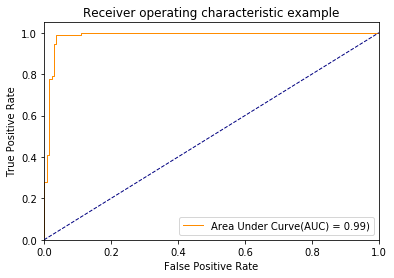

In [151]:
from imblearn.under_sampling import InstanceHardnessThreshold
iht = InstanceHardnessThreshold(random_state=42)
columns = savedFeaturesforL.columns
savedFeaturesforL, savedLabelsforL = iht.fit_sample(savedFeaturesforL, savedLabelsforL)
model1 = SelectKBest(chi2).fit(savedFeaturesforL, savedLabelsforL)
savedFeaturesforL = pd.DataFrame(savedFeaturesforL,columns=columns)
columns = savedFeaturesforL.columns
labels = [columns[x] for x in model1.get_support(indices=True) if x]
#        newTrain = pd.DataFrame(model1.transform(trainFeatures),columns=labels)
newTrain = savedFeaturesforL[labels]

newTrain.index = savedFeaturesforL.index
model = sm.Logit(savedLabelsforL,newTrain)
result = model.fit(maxiter =15)
print(result.summary(),"\n\n")
newTest = X_test[labels]
newTest.index = X_test.index
y_test.index = newTest.index
resultFrame = pd.DataFrame()
resultFrame["predicted"] = result.predict(newTrain)
resultFrame["score"] = resultFrame["predicted"]
mask1 = resultFrame["predicted"]>0.5
mask = resultFrame["predicted"]<=0.5
resultFrame.ix[mask1,"predicted"] = 1
resultFrame.ix[mask,"predicted"] = 0
resultFrame["actual"] = savedLabelsforL

tn, fp, fn, tp = confusion_matrix(resultFrame["actual"],resultFrame["predicted"]).ravel()
print("\t\tConfusion Matrix")
print("True Positives : ",tp)
print("True Negatives : ",tn)
print("False Positives : ",fp)
print("False Negatives : ",fn)

#Code from scikit learn documentation example

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(0,2):
    fpr[i], tpr[i], _ = roc_curve(resultFrame["actual"], resultFrame["score"])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(resultFrame["actual"].ravel(),  resultFrame["score"].ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 1
plt.plot(fpr[1], tpr[1], color='darkorange',
         lw=lw, label='Area Under Curve(AUC) = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

Under-Sampling has proved to be fruitful in improving the accuracy of the model which is evident form the confusion matrix and ROC. The misclassification rate of bending data has been reduced from 53% to 7%.

# (e) Binary Classification Using L1-penalized logistic regression

i. Repeat 1(d)iii using L1-penalized logistic regression, i.e. instead of using pvalues for variable selection, use L1 regularization. Note that in this problem, you have to cross-validate for both l, the number of time series into which you break each of your instances, and C, the weight of L1 penalty in your logistic regression objective function. Packages usually perform cross-validation for C automatically.

In [160]:
import pandas as pd
import os
from collections import defaultdict
import matplotlib.pyplot as plt
#import bootstrapped.bootstrap as bs
#import bootstrapped.stats_functions as bs_stats
import statsmodels.formula.api as sm
from patsy import dmatrices, build_design_matrices
from sklearn import preprocessing
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
def getTrainingFeatures(activity,splitSize,Test):
    if(Test):
        root_dir = "AReM/Test/"+activity
    else:
        root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["time","avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            if(Test):
                fileContents = pd.read_csv("AReM/Test/"+activity+"/"+file,comment="#",names=col_Names)
            else:
                fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            size = len(fileContents.index)
            segment = int(size/splitSize)
#            print(size)
#            print(segment)
            dfList = []
            for i in range(0,size,int(segment)):
#                print(i)
                dfList.append(fileContents[i:segment+i])
            for df in dfList:
                meanFrame = df.mean()
                maxFrame = df.max()
                medianFrame = df.median()
                stdFrame = df.std()
                firstQuartileFrame = df.quantile(0.25)
                thirdQuartileFrame = df.quantile(0.75)
                colNames=["avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
                for col in colNames:
                    datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                    datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                    datapointFrame.setdefault(col+"_median",[]).append(medianFrame[col])
                    datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
                if(activity=="bending1" or activity=="bending2"):
                    datapointFrame.setdefault("activity",[]).append(1)
                else:
                    datapointFrame.setdefault("activity",[]).append(0)
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame
            
            
activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]

Resultstring = ""
leastErrorLvalue = 0
leastError = 100
savedFeaturesforL  = pd.DataFrame()
savedLabelsforL = pd.DataFrame()
for i in range(1,11):
    trainingData = pd.DataFrame()
    frames = []
    for activity in activityList:
        activityFrame = getTrainingFeatures(activity,i,0)
        frames.append(activityFrame)
    trainingData = pd.concat(frames)
    featureStdFrame = trainingData.std()
    #print(featureStdFrame)
#    print(trainingData)
    trainingData.to_csv("outsplit"+str(i)+".csv", sep='\t', encoding='utf-8')
    headers=""
    for colName in list(trainingData.columns.values)[1:]:
        headers+=colName+" + "
#    print(headers[:-2])
    kf = StratifiedKFold(n_splits=5,shuffle = True)
    new_index= list(range(0,len(trainingData)))
    allLabels = trainingData["activity"]
    allFeatures = trainingData.iloc[:,1:]
    df_normalized = (allFeatures - allFeatures.min()) / (allFeatures.max() - allFeatures.min())
#    df_normalized = trainingData
    df_normalized.index = new_index
    allLabels.index = new_index
#    print(df_normalized)
    n=1
    sumOfError=0
    Cvalues = list(range(1,1000,100))
    #Cross-validation for L
    for train, test in kf.split(df_normalized,allLabels):
        resultFrame = pd.DataFrame()
        trainFeatures = df_normalized.ix[train]
        trainLabels = allLabels.ix[train]
        testFeatures = df_normalized.ix[test]
        testLabels = allLabels.ix[test]
#        print(testLabels)
        
        logisticRegr = LogisticRegressionCV(penalty = 'l1',solver='liblinear').fit(trainFeatures, trainLabels)
        model1 = SelectFromModel(logisticRegr, prefit=True)

        columns = trainFeatures.columns
        labels = [columns[x] for x in model1.get_support(indices=True) if x]
#        newTrain = pd.DataFrame(model1.transform(trainFeatures),columns=labels)
        if(len(labels)!=0):
            newTrain = trainFeatures[labels]
    #        newTest = pd.DataFrame(model1.transform(testFeatures),columns=labels)
            newTest = testFeatures[labels]
            newTrain.index = trainFeatures.index
            newTest.index = testLabels.index
            logisticRegr = LogisticRegression(max_iter=10).fit(newTrain, trainLabels)
    #        model = sm.Logit(trainLabels,newTrain)
    #        result = model.fit(maxiter =10)
    #        print(newTest)
            resultFrame["predicted"] = logisticRegr.predict(newTest)
            mask1 = resultFrame["predicted"]>0.5
            mask = resultFrame["predicted"]<=0.5
            resultFrame.ix[mask1,"predicted"] = 1
            resultFrame.ix[mask,"predicted"] = 0
            resultFrame.index = testLabels.index
            resultFrame["actual"] = testLabels
    #            print("*************************************** kthFold = "+str(n)+"*********** l value = "+str(i)+" c=",c)
    #            print(result.summary())
    #        print(resultFrame)
#             mse = mean_squared_error(resultFrame["actual"], resultFrame["predicted"])
            error = 1-logisticRegr.score(newTest,testLabels)
            sumOfError+=error
    #         print(mse)
            n+=1
    #    print("For l = "+ str(i)+ "Average MSE = " + str(sumOfMSE/5))
    Resultstring += "For l = "+ str(i)+ "Average Error over all values of C = " + str(sumOfError/n)+"\n"
    if((sumOfError/n)<leastError):
        leastError = sumOfError/n
        leastErrorLvalue = i
        savedFeaturesforL = df_normalized
        savedLabelsforL = allLabels
print(Resultstring)

print("\nAccuracy in cross validation of L and C(by package) = "+ str((1- leastError)*100)+ "\nBestLvalue = "+ str(leastErrorLvalue))


For l = 1Average Error over all values of C = 0.108058608059
For l = 2Average Error over all values of C = 0.0895669889923
For l = 3Average Error over all values of C = 0.0717986116738
For l = 4Average Error over all values of C = 0.075225943647
For l = 5Average Error over all values of C = 0.0746031746032
For l = 6Average Error over all values of C = 0.0682771737356
For l = 7Average Error over all values of C = 0.0695058695059
For l = 8Average Error over all values of C = 0.0647173959674
For l = 9Average Error over all values of C = 0.0591787439614
For l = 10Average Error over all values of C = 0.0530705870087


Accuracy in cross validation of L and C(by package) = 94.6929412991
BestLvalue = 10


ii. Compare the L1-penalized with variable selection using p-values. Which one performs better? Which one is easier to implement?

In [163]:
logisticRegr = LogisticRegressionCV(max_iter=10,penalty = 'l1',solver='liblinear').fit(savedFeaturesforL, savedLabelsforL)
model1 = SelectFromModel(logisticRegr, prefit=True)

columns = savedFeaturesforL.columns
labels = [columns[x] for x in model1.get_support(indices=True) if x]
#        newTrain = pd.DataFrame(model1.transform(trainFeatures),columns=labels)
newTrain = savedFeaturesforL[labels]

newTrain.index = savedFeaturesforL.index
model = sm.Logit(savedLabelsforL,newTrain)
result = model.fit(maxiter =15)

print(result.summary(),"\n\n")
frames = list()
for activity in activityList:
    activityFrame = getTrainingFeatures(activity,leastErrorLvalue,1)
    frames.append(activityFrame)
testingData = pd.concat(frames)
testLabels = testingData["activity"]
testFeatures = testingData.iloc[:,1:]
test_normalized = (testFeatures - testFeatures.min()) / (testFeatures.max() - testFeatures.min())
new_index= list(range(0,len(testingData)))
test_normalized.index = new_index
testLabels.index = new_index
newTest = test_normalized[labels]
resultFrame = pd.DataFrame()
resultFrame["predicted"] = result.predict(newTest)
resultFrame["score"] = resultFrame["predicted"]
mask1 = resultFrame["predicted"]>0.5
mask = resultFrame["predicted"]<=0.5
resultFrame.ix[mask1,"predicted"] = 1
resultFrame.ix[mask,"predicted"] = 0
resultFrame["actual"] = testLabels
logisticRegr.fit(newTrain,savedLabelsforL)
error = 1-logisticRegr.score(newTest,testLabels)
print("For the optimal l-value :",leastErrorLvalue)
print("Accuracy on test set = ",(1-error)*100)

Optimization terminated successfully.
         Current function value: 0.134221
         Iterations 11
                           Logit Regression Results                           
Dep. Variable:               activity   No. Observations:                  691
Model:                          Logit   Df Residuals:                      681
Method:                           MLE   Df Model:                            9
Date:                Fri, 16 Feb 2018   Pseudo R-squ.:                  0.6530
Time:                        13:54:10   Log-Likelihood:                -92.747
converged:                       True   LL-Null:                       -267.32
                                        LLR p-value:                 9.452e-70
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
avg_rss12_max        4.5919      3.181      1.443      0.149      -1.643      10.827
avg_rss12_

L1 penalise algorithm works better. For the optimal C value selected the algorithm makes use of the significant co-efficients and makes predictions with a better accuracy which is approximately 12% greater than l2 regularized and p-value eliminated feature selection. This is a drastic improvement in the model. Hence this model is parse model which on appropriate C value uses only the significant variables to effectively build a model.

# (f) Multi-class Classification (The Realistic Case)

i. Use the best l you found6 from 1(e)i to build an L1-penalized multinomial regression model to classify all activities in your training set.7 Report your test error. Research how confusion matrices and ROC curves are defined for multiclass classification and show them for this problem if possible.


Test Error = 21.5789473684% for 10-splits of test and train data

Confusion Matrix on the train data

[[ 41   0   0   0   7   2   0]
 [  1  25   0   5   9   0   0]
 [  0   0 113   0   0   0   7]
 [  0   4   0 107   0   9   0]
 [  8   7   4  11  68  23   0]
 [  1   0   0   8  22  89   0]
 [  0   0   1   0   0   0 119]]
\ROC on the train data



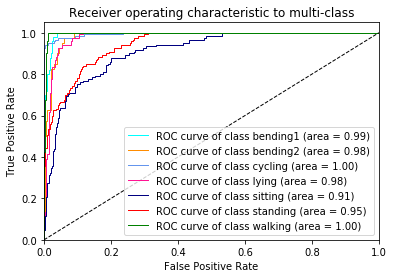

In [171]:
import pandas as pd
import os
from collections import defaultdict
import matplotlib.pyplot as plt
import statsmodels.formula.api as sm
from patsy import dmatrices, build_design_matrices
from sklearn import preprocessing
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn import preprocessing
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
def getTrainingFeatures3(activity,splitSize,Test):
    if(Test):
        root_dir = "AReM/Test/"+activity
    else:
        root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["time","avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            if(Test):
                fileContents = pd.read_csv("AReM/Test/"+activity+"/"+file,comment="#",names=col_Names)
            else:
                fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            size = len(fileContents.index)
            segment = int(size/splitSize)
#            print(size)
#            print(segment)
            dfList = []
            for i in range(0,size,int(segment)):
#                print(i)
                dfList.append(fileContents[i:segment+i])
            for df in dfList:
                meanFrame = df.mean()
                maxFrame = df.max()
                medianFrame = df.median()
                firstQuartileFrame = df.quantile(0.25)
                thirdQuartileFrame = df.quantile(0.75)
                colNames=["avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
                for col in colNames:
                    datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                    datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                    datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
                    datapointFrame.setdefault(col+"_median",[]).append(medianFrame[col])
                datapointFrame.setdefault("activity",[]).append(activity)
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame
            
            
activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]

Resultstring = ""
leastErrorLvalue = 0
leastError = 100
savedFeaturesforL  = pd.DataFrame()
savedLabelsforL = pd.DataFrame()

trainingData = pd.DataFrame()
frames = []
for activity in activityList:
    activityFrame = getTrainingFeatures3(activity,10,0)
    frames.append(activityFrame)
trainingData = pd.concat(frames)

new_index= list(range(0,len(trainingData)))
allLabels = pd.DataFrame()
allLabels["activity"] = trainingData["activity"]
le = preprocessing.LabelEncoder()
le.fit(allLabels["activity"])
allLabels["activity"]=le.transform(allLabels["activity"])
allFeatures = trainingData.iloc[:,1:]
df_normalized = (allFeatures - allFeatures.min()) / (allFeatures.max() - allFeatures.min())
#    df_normalized = trainingData
df_normalized.index = new_index
allLabels.index = new_index
#    print(df_normalized)
logisticRegr = LogisticRegressionCV(solver='liblinear',penalty='l1').fit(df_normalized, allLabels)
model1 = SelectFromModel(logisticRegr, prefit=True)
columns = allFeatures.columns
labels = [columns[x] for x in model1.get_support(indices=True) if x]
newTrain = df_normalized[labels]
frames = []
for activity in activityList:
    activityFrame = getTrainingFeatures3(activity,10,1)
    frames.append(activityFrame)
testingData = pd.concat(frames)

new_index= list(range(0,len(testingData)))
testLabels = pd.DataFrame()
testLabels["activity"] = testingData["activity"]
testLabels["activity"]=le.transform(testLabels["activity"])
testFeatures = testingData.iloc[:,1:]

test_normalized = (testFeatures - testFeatures.min()) / (testFeatures.max() - testFeatures.min())
test_normalized.index = new_index
testLabels.index = new_index

newTest = test_normalized[labels]
newTrain.index = df_normalized.index
newTest.index = testLabels.index
logisticRegr = LogisticRegression(solver='liblinear',penalty="l1").fit(newTrain,allLabels)
resultFrame = pd.DataFrame()
resultFrame["actual"] = testLabels
probabilityFrame = logisticRegr.predict_proba(newTest)
testError = 1 - logisticRegr.score(newTest,testLabels)
print("\nTest Error = "+ str(testError*100)+"% for 10-splits of test and train data")

logisticRegr = LogisticRegression(solver='liblinear',penalty="l1").fit(newTrain,allLabels)
resultFrame = pd.DataFrame()
resultFrame["actual"] = allLabels
resultFrame["predicted"] = logisticRegr.predict(newTrain)
probabilityFrame = logisticRegr.predict_proba(newTrain)
testError = 1 - logisticRegr.score(newTrain,allLabels)
CMat = confusion_matrix(resultFrame["actual"],resultFrame["predicted"])
print("\nConfusion Matrix on the train data\n")
print(CMat)
#Code from scikit learn documentation example
# Binarize the output
y = label_binarize(resultFrame["actual"], classes=[0, 1, 2,3,4,5,6,7])
n_classes = y.shape[1]
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(0,7):
    fpr[i], tpr[i], _ = roc_curve(y[:,i], probabilityFrame[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])
plt.figure()
lw = 1
colors = ['aqua', 'darkorange', 'cornflowerblue','deeppink','navy','red','green']
for i, color in zip(range(0,7), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(le.inverse_transform(np.array(i)), roc_auc[i]))
    
plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic to multi-class')
plt.legend(loc="lower right")
print("\ROC on the train data\n")
plt.show()

ii. Repeat 1(f)i using a Na¨ıve Bayes’ classifier. Use both Gaussian and Multinomial priors and compare the results.


Test Error = 16.3157894737% for 10-splits of test and train data(Gaussian)

Confusion Matrix on the train data

[[ 48   0   0   0   1   1   0]
 [  3  26   0  10   1   0   0]
 [  0   0 117   0   0   0   3]
 [  0   0   0 114   6   0   0]
 [  5  12   0  10  58  36   0]
 [  0   0   0   5  19  96   0]
 [  0   0   0   0   0   0 120]]


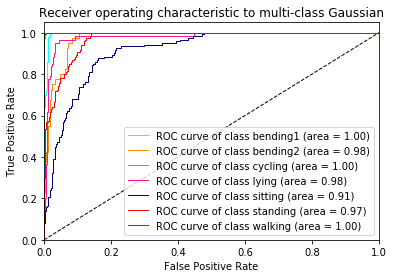


Test Error = 46.8421052632% for 10-splits of test and train data(Multinomial priors)

Confusion Matrix on the train data

[[  2   0   0   0  44   4   0]
 [  0   0   3   1  36   0   0]
 [  0   0 114   0   0   0   6]
 [  0   0   8  73  13  26   0]
 [  0   0   0  12  81  28   0]
 [  0   0   0  10  26  84   0]
 [  0   0   0   0   0   0 120]]


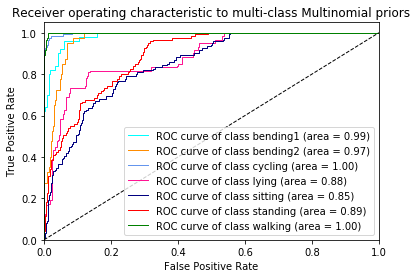

In [174]:
import pandas as pd
import os
from collections import defaultdict
import matplotlib.pyplot as plt
import statsmodels.formula.api as sm
from patsy import dmatrices, build_design_matrices
from sklearn import preprocessing
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import SelectFromModel
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.naive_bayes import MultinomialNB
from sklearn import preprocessing
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
def getTrainingFeatures3(activity,splitSize,Test):
    if(Test):
        root_dir = "AReM/Test/"+activity
    else:
        root_dir = "AReM/Training/"+activity
    fileList = os.listdir(root_dir)
    datapointFrame = defaultdict()
    col_Names=["time","avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
    for file in fileList:
        if not file.startswith('.'):
            if(Test):
                fileContents = pd.read_csv("AReM/Test/"+activity+"/"+file,comment="#",names=col_Names)
            else:
                fileContents = pd.read_csv("AReM/Training/"+activity+"/"+file,comment="#",names=col_Names)
            size = len(fileContents.index)
            segment = int(size/splitSize)
#            print(size)
#            print(segment)
            dfList = []
            for i in range(0,size,int(segment)):
#                print(i)
                dfList.append(fileContents[i:segment+i])
            for df in dfList:
                meanFrame = df.mean()
                maxFrame = df.max()
                medianFrame = df.median()
                firstQuartileFrame = df.quantile(0.25)
                thirdQuartileFrame = df.quantile(0.75)
                colNames=["avg_rss12","var_rss12","avg_rss13","var_rss13","avg_rss23","var_rss23"]
                for col in colNames:
                    datapointFrame.setdefault(col+"_mean",[]).append(meanFrame[col])
                    datapointFrame.setdefault(col+"_max",[]).append(maxFrame[col])
                    datapointFrame.setdefault(col+"_IQR",[]).append(thirdQuartileFrame[col] - firstQuartileFrame[col])
                    datapointFrame.setdefault(col+"_median",[]).append(medianFrame[col])
                datapointFrame.setdefault("activity",[]).append(activity)
            activityFrame = pd.DataFrame(datapointFrame)
    return activityFrame
            
            
activityList = ["bending1","bending2","cycling","lying","sitting","standing","walking"]

Resultstring = ""
leastErrorLvalue = 0
leastError = 100
savedFeaturesforL  = pd.DataFrame()
savedLabelsforL = pd.DataFrame()

trainingData = pd.DataFrame()
frames = []
for activity in activityList:
    activityFrame = getTrainingFeatures3(activity,10,0)
    frames.append(activityFrame)
trainingData = pd.concat(frames)

new_index= list(range(0,len(trainingData)))
allLabels = pd.DataFrame()
allLabels["activity"] = trainingData["activity"]
le = preprocessing.LabelEncoder()
le.fit(allLabels["activity"])
allLabels["activity"]=le.transform(allLabels["activity"])
allFeatures = trainingData.iloc[:,1:]
df_normalized = (allFeatures - allFeatures.min()) / (allFeatures.max() - allFeatures.min())
df_normalized.index = new_index
allLabels.index = new_index
clf = GaussianNB().fit(df_normalized,allLabels)
labels = allFeatures.columns
newTrain = df_normalized[labels]
frames = []
for activity in activityList:
    activityFrame = getTrainingFeatures3(activity,10,1)
    frames.append(activityFrame)
testingData = pd.concat(frames)

new_index= list(range(0,len(testingData)))
testLabels = pd.DataFrame()
testLabels["activity"] = testingData["activity"]
testLabels["activity"]=le.transform(testLabels["activity"])

testFeatures = testingData.iloc[:,1:]

test_normalized = (testFeatures - testFeatures.min()) / (testFeatures.max() - testFeatures.min())
test_normalized.index = new_index
testLabels.index = new_index

newTest = test_normalized[labels]
newTrain.index = df_normalized.index
newTest.index = testLabels.index
clf.fit(newTrain,allLabels)
resultFrame = pd.DataFrame()
resultFrame["actual"] = testLabels
probabilityFrame = clf.predict_proba(newTest)
testError = 1 - clf.score(newTest,testLabels)
print("\nTest Error = "+ str(testError*100)+"% for 10-splits of test and train data(Gaussian)")

clf.fit(newTrain,allLabels)
resultFrame = pd.DataFrame()
resultFrame["actual"] = allLabels
resultFrame["predicted"] = clf.predict(newTrain)
probabilityFrame = clf.predict_proba(newTrain)
CMat = confusion_matrix(resultFrame["actual"],resultFrame["predicted"])
print("\nConfusion Matrix on the train data\n")
print(CMat)

#Code from scikit learn documentation example
# Binarize the output
y = label_binarize(resultFrame["actual"], classes=[0, 1, 2,3,4,5,6,7])
n_classes = y.shape[1]
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(0,7):
    fpr[i], tpr[i], _ = roc_curve(y[:,i], probabilityFrame[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])
plt.figure()
lw = 1
colors = ['aqua', 'darkorange', 'cornflowerblue','deeppink','navy','red','green']
for i, color in zip(range(0,7), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(le.inverse_transform(np.array(i)), roc_auc[i]))
    
plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic to multi-class Gaussian')
plt.legend(loc="lower right")
plt.show()

clf = MultinomialNB()
clf.fit(newTrain,allLabels)
resultFrame = pd.DataFrame()
resultFrame["actual"] = testLabels
resultFrame["predicted"] = clf.predict(newTest)
probabilityFrame = clf.predict_proba(newTest)
testError = 1 - clf.score(newTest,testLabels)
print("\nTest Error = "+ str(testError*100)+"% for 10-splits of test and train data(Multinomial priors)")

clf.fit(newTrain,allLabels)
resultFrame = pd.DataFrame()
resultFrame["actual"] = allLabels
resultFrame["predicted"] = clf.predict(newTrain)
probabilityFrame = clf.predict_proba(newTrain)
CMat = confusion_matrix(resultFrame["actual"],resultFrame["predicted"])
print("\nConfusion Matrix on the train data\n")
print(CMat)

#Code from scikit learn documentation example
# Binarize the output
y = label_binarize(resultFrame["actual"], classes=[0, 1, 2,3,4,5,6,7])
n_classes = y.shape[1]
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(0,7):
    fpr[i], tpr[i], _ = roc_curve(y[:,i], probabilityFrame[:,i])
    roc_auc[i] = auc(fpr[i], tpr[i])
plt.figure()
lw = 1
colors = ['aqua', 'darkorange', 'cornflowerblue','deeppink','navy','red','green']
for i, color in zip(range(0,7), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(le.inverse_transform(np.array(i)), roc_auc[i]))
    
plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic to multi-class Multinomial priors')
plt.legend(loc="lower right")
plt.show()


iii. Which method is better for multi-class classification in this problem?

Gaussian Naive Baye's has recorded the lease error in classification which is 16.31% followed by L1-penalized algorithm which is 21.5%. 

# 2. ISLR 3.7.4

4. I collect a set of data (n = 100 observations) containing a single predictor and a quantitative response. I then fit a linear regression model to the data, as well as a separate cubic regression, i.e. Y = β0 +β1X +β2X2 +β3X3 +ε.

(a) Suppose that the true relationship between X and Y is linear, i.e. Y = β0 + β1X + ε. Consider the training residual sum of squares (RSS) for the linear regression, and also the training RSS for the cubic regression. Would we expect one to be lower than the other, would we expect them to be the same, or is there not enough information to tell? Justify your answer.

Though the true relation is linear, RSS of the cubic model can be expected to be lower than linear model. But we dont use the cubic model as true model because this may overfit the data to create higher variance.

(b) Answer (a) using test rather than training RSS.

This depends on the test data and we cannot conclude anything depending on the true relation of training data.

(c) SupposethatthetruerelationshipbetweenXandYisnotlinear, but we don’t know how far it is from linear. Consider the training RSS for the linear regression, and also the training RSS for the cubic regression. Would we expect one to be lower than the other, would we expect them to be the same, or is there not enough information to tell? Justify your answer.

Since the true relationship is not linear, we can expect the training RSS to be less for cubic regression since the polynolmial regression fits non - linear data better than linear regression.

(d) Answer (c) using test rather than training RSS.

Again this can be concluded only by knowing the nature of test data. If the test data is far from linear then polynomial regression gives a lesser RSS, but if the test data is close to linear but not linear then linear regression gives a better RSS.

# 3. ISLR, 4.7.3

This problem relates to the QDA model, in which the observations within each class are drawn from a normal distribution with a class- specific mean vector and a class specific covariance matrix. We consider the simple case where p = 1; i.e. there is only one feature.
Suppose that we have K classes, and that if an observation belongs to the kth class then X comes from a one-dimensional normal dis- tribution, X ∼N(μk,σk2). Recall that the density function for the one-dimensional normal distribution is given in (4.11). Prove that in this case, the Bayes’ classifier is not linear. Argue that it is in fact quadratic.

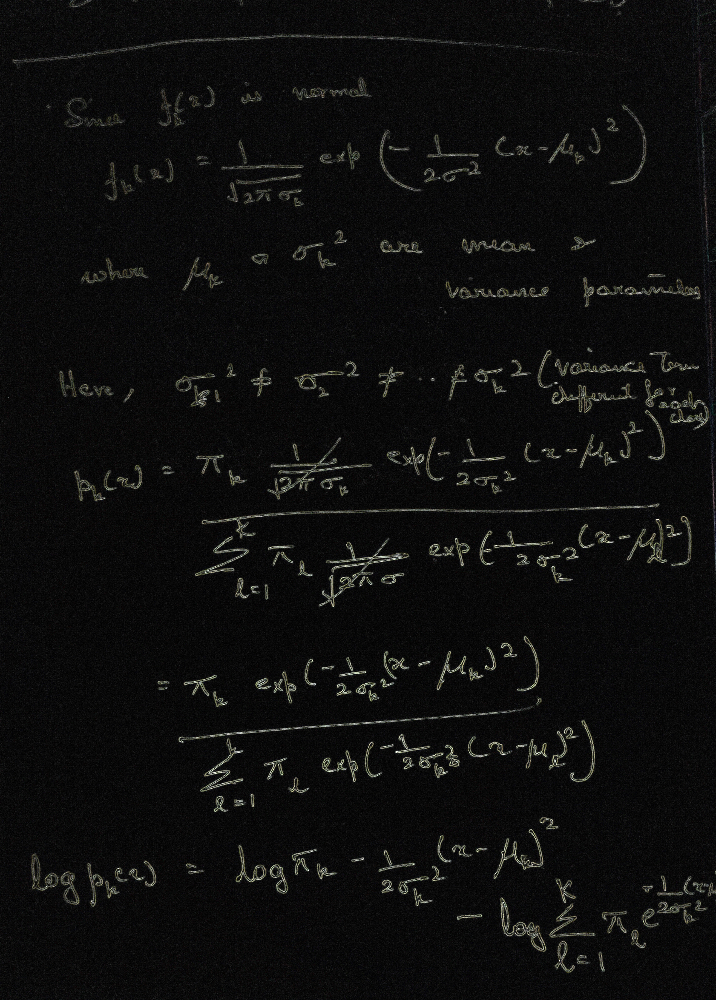

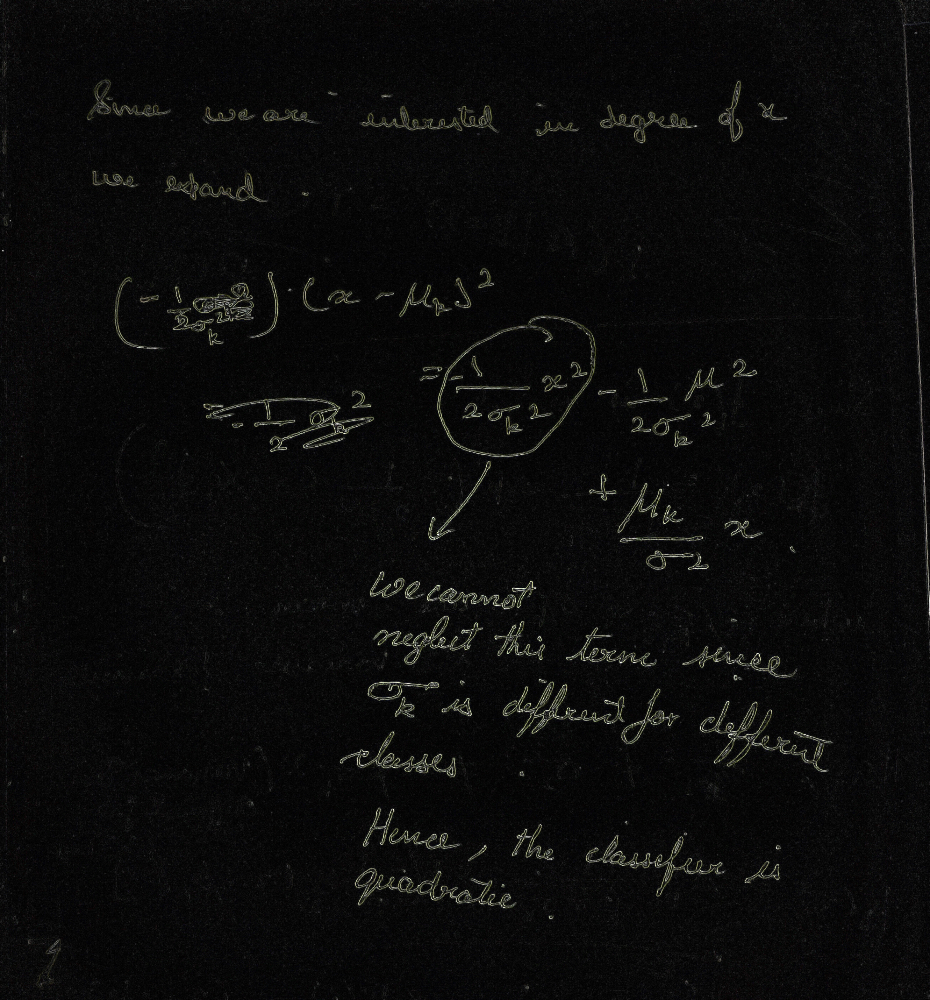

# 4. ISLR 4.7.7

7. Suppose that we wish to predict whether a given stock will issue a dividend this year (“Yes” or “No”) based on X, last year’s percent profit. We examine a large number of companies and discover that the mean value of X for companies that issued a dividend was X ̄ = 10, while the mean for those that didn’t was X ̄ = 0. In addition, the variance of X for these two sets of companies was σˆ2 = 36. Finally, 80 % of companies issued dividends. Assuming that X follows a nor- mal distribution, predict the probability that a company will issue a dividend this year given that its percentage profit was X = 4 last year.


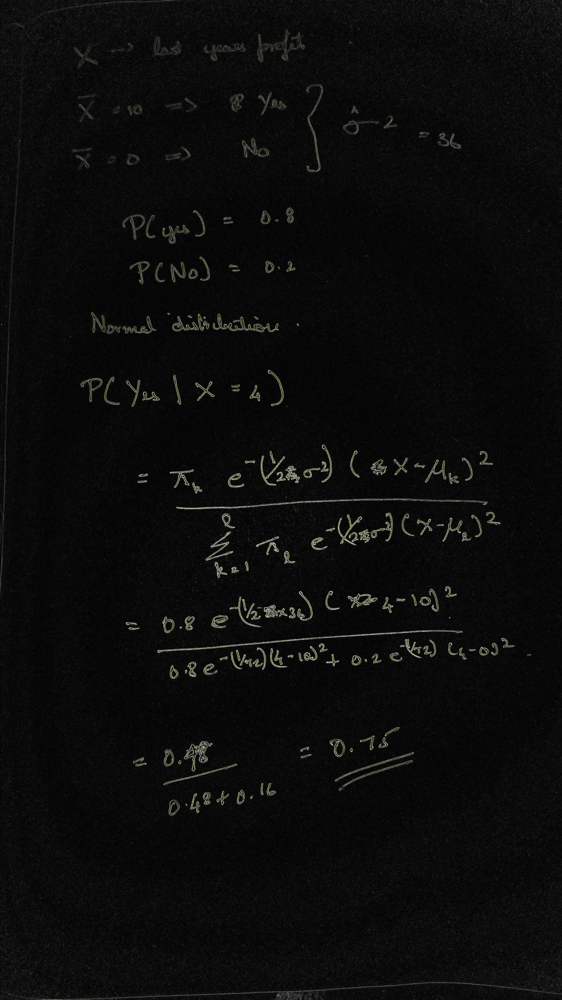